In [2]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2
import numpy as np
import io
import base64

In [6]:
# Lucas Kanade
import numpy as np
import cv2 as cv

cap = cv.VideoCapture('short_test.mp4')
# params for ShiTomasi corner detection
feature_params = dict( maxCorners = 70,
                       qualityLevel = 0.3,
                       minDistance = 7,
                       blockSize = 7 )
# Parameters for lucas kanade optical flow
lk_params = dict( winSize  = (15,15),
                  maxLevel = 2,
                  criteria = (cv.TERM_CRITERIA_EPS | cv.TERM_CRITERIA_COUNT, 10, 0.03))
# Create some random colors
color = np.random.randint(0,255,(100,3))
# Take first frame and find corners in it
ret, old_frame = cap.read()
old_gray = cv.cvtColor(old_frame, cv.COLOR_BGR2GRAY)
p0 = cv.goodFeaturesToTrack(old_gray, mask = None, **feature_params)
# Create a mask image for drawing purposes
mask = np.zeros_like(old_frame)
how_many_loops = 0

while(how_many_loops < 140):
    how_many_loops += 1
    try:
        ret, frame = cap.read()
        if ret == False:
            break
        frame_gray = cv.cvtColor(frame, cv.COLOR_BGR2GRAY)
        # calculate optical flow
        p1, st, err = cv.calcOpticalFlowPyrLK(old_gray, frame_gray, p0, None, **lk_params)
        # Select good points
        good_new = p1[st==1]
        good_old = p0[st==1]
        # draw the tracks
        for i,(new,old) in enumerate(zip(good_new,good_old)):
            a,b = new.ravel()
            c,d = old.ravel()
            mask = cv.line(mask, (a,b),(c,d), color[i].tolist(), 2)
            frame = cv.circle(frame,(a,b),5,color[i].tolist(),-1)
        img = cv.add(frame,mask)
        cv.imshow('frame',img)
        k = cv.waitKey(30) & 0xff
        if k == 27:
            break
        # Now update the previous frame and previous points
        old_gray = frame_gray.copy()
        p0 = good_new.reshape(-1,1,2)
        #cv.waitKey(0) # this waits for a click to move the frame forward
    except:
        break

cv.destroyAllWindows()
cap.release()
cv.destroyAllWindows()

### To make test clip

In [10]:
from moviepy.editor import VideoFileClip

clip = VideoFileClip("MarketStreet1906WithStreetSounds.mp4")
starting_point = 120  # start at second minute
end_point = 125  # record for 300 seconds (120+300)
subclip = clip.subclip(starting_point, end_point)
%time subclip.write_videofile("short_test.mp4", audio=False)

[MoviePy] >>>> Building video short_test.mp4
[MoviePy] Writing video short_test.mp4


100%|██████████| 150/150 [00:01<00:00, 105.36it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: short_test.mp4 

CPU times: user 105 ms, sys: 84.1 ms, total: 189 ms
Wall time: 1.82 s


### Calculate distance / frame

1st and Market is at about 5:05.25, and 3rd and Market at 7:38.35, which is almost exactly 500 meters away.
How many frames pass?

In [18]:
from moviepy.editor import VideoFileClip

clip = VideoFileClip("MarketStreet1906WithStreetSounds.mp4")
starting_point = 5*60+5.25  # start at second minute
end_point = 7*60+38.1  # record for 300 seconds (120+300)
subclip = clip.subclip(starting_point, end_point)
%time subclip.write_videofile("for_measuring_dist.mp4", audio=False)

[MoviePy] >>>> Building video for_measuring_dist.mp4
[MoviePy] Writing video for_measuring_dist.mp4


100%|██████████| 4581/4581 [00:46<00:00, 98.43it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: for_measuring_dist.mp4 

CPU times: user 3.07 s, sys: 1.82 s, total: 4.89 s
Wall time: 46.9 s


In [19]:
video = io.open('for_measuring_dist.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''
<video controls>
    <source src="data:video/mp4;base64,{0}" type="video/mp4" />
</video>'''.format(encoded.decode('ascii')))

### Helper functions and function that plots cable car tracks

In [6]:
import math
from line import Line


def grayscale(img):
    """Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    (assuming your grayscaled image is called 'gray')
    you should call plt.imshow(gray, cmap='gray')"""
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Or use BGR2GRAY if you read an image with cv2.imread()
    # return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    
def canny(img, low_threshold, high_threshold):
    """Applies the Canny transform"""
    return cv2.Canny(img, low_threshold, high_threshold)

def gaussian_blur(img, kernel_size):
    """Applies a Gaussian Noise kernel"""
    return cv2.GaussianBlur(img, (kernel_size, kernel_size), 0)

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    `vertices` should be a numpy array of integer points.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def draw_lines(img, lines, color=[255, 0, 0], thickness=2):
    """
    NOTE: this is the function you might want to use as a starting point once you want to 
    average/extrapolate the line segments you detect to map out the full
    extent of the lane (going from the result shown in raw-lines-example.mp4
    to that shown in P1_example.mp4).  
    
    Think about things like separating line segments by their 
    slope ((y2-y1)/(x2-x1)) to decide which segments are part of the left
    line vs. the right line.  Then, you can average the position of each of 
    the lines and extrapolate to the top and bottom of the lane.
    
    This function draws `lines` with `color` and `thickness`.    
    Lines are drawn on the image inplace (mutates the image).
    If you want to make the lines semi-transparent, think about combining
    this function with the weighted_img() function below
    """
    for line in lines:
        for x1,y1,x2,y2 in line:
            cv2.line(img, (x1, y1), (x2, y2), color, thickness)

def hough_lines(img, rho, theta, threshold, min_line_len, max_line_gap):
    """
    `img` should be the output of a Canny transform.
        
    Returns an image with hough lines drawn.
    """
    lines = cv2.HoughLinesP(img, rho, theta, threshold, minLineLength=min_line_len, maxLineGap=max_line_gap)
    line_img = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.uint8)
    draw_lines(line_img, lines)
    return line_img

# Python 3 has support for cool math symbols.

def weighted_img(img, initial_img, α=0.8, β=1., γ=0.):
    """
    `img` is the output of the hough_lines(), An image with lines drawn on it.
    Should be a blank image (all black) with lines drawn on it.
    
    `initial_img` should be the image before any processing.
    
    The result image is computed as follows:
    
    initial_img * α + img * β + γ
    NOTE: initial_img and img must be the same shape!
    """
    return cv2.addWeighted(initial_img, α, img, β, γ)


def find_middle_line(lines):
    try:
        # if length is odd
        if (len(lines) % 2):
            mid_slope = np.median([l.slope for l in lines])
            for line in lines:
                if line.slope == mid_slope:
                    return line
        # and if length is even
        else:
            sorted_ms = np.sort([l.slope for l in lines])
            lower_mid_m = sorted_ms[int((len(sorted_ms)/2) - 1)]
            upper_mid_m = sorted_ms[int(len(sorted_ms)/2)]
            # return line closest to median slope
            if abs(lower_mid_m - np.median([l.slope for l in lines])) <  abs(upper_mid_m - np.median([l.slope for l in lines])):
                for line in lines:
                    if line.slope == lower_mid_m:
                        return line
            else:
                for line in lines:
                    if line.slope == upper_mid_m:
                        return line
    except:
        pass
    
# extend lines from median line
def extend_line(line, min_y, max_y):
    x_for_max_y = int((max_y-line.b)/line.slope)
    x_for_min_y = int((min_y-line.b)/line.slope) 

    return Line(x_for_min_y, min_y, x_for_max_y, max_y)


def find_intersection(line1, line2):
    '''
    Finds point of intersection between two lines.
    x = (b2 - b1)/(m1 - m2)
    '''
    x = (line2.b - line1.b)/(line1.slope - line2.slope)
    y = line1.slope*x + line1.b
    return (x, y)

In [7]:
def image_processing_pipeline(image):
     
    gray = grayscale(image)

    try:
        # Define a kernel size and apply Gaussian smoothing
        kernel_size = 7
        blur_gray = cv2.GaussianBlur(gray,(kernel_size, kernel_size), 0)

        # Define our parameters for Canny and apply
        low_threshold = 70
        high_threshold = 150
        edges = cv2.Canny(blur_gray, low_threshold, high_threshold)

        # Next create a masked edges image using cv2.fillPoly()
        mask = np.zeros_like(edges)   
        ignore_mask_color = 255

        # This time we are defining a four sided polygon to mask
        imshape = image.shape
        vertices = np.array([[(150,imshape[0]), (245, 40), (360, imshape[0]),(350, imshape[0]), 
                      (245, imshape[0]-265), (160,imshape[0])]], dtype=np.int32)
        cv2.fillPoly(mask, vertices, ignore_mask_color)
        masked_edges = cv2.bitwise_and(edges, mask)

        # Define the Hough transform parameters
        # Make a blank the same size as our image to draw on
        rho = 2 # distance resolution in pixels of the Hough grid
        theta = np.pi/180 # angular resolution in radians of the Hough grid
        threshold = 5     # minimum number of votes (intersections in Hough grid cell)
        min_line_length = 30 # minimum number of pixels making up a line
        max_line_gap = 200    # maximum gap in pixels between connectable line segments
        line_image = np.copy(image)*0 # creating a blank to draw lines on

        # Run Hough on edge detected image
        # Output "lines" is an array containing endpoints of detected line segments
        lines = cv2.HoughLinesP(masked_edges, rho, theta, threshold, np.array([]),
                                    min_line_length, max_line_gap)

        # put lines in a list
        detected_lines = [Line(l[0][0], l[0][1], l[0][2], l[0][3]) for l in lines]

        if len(detected_lines) != 0:
            candidate_lines = []
            for line in detected_lines:
                    # consider only lines with certain slopes
                    # inspired by https://github.com/ndrplz/self-driving-car/blob/master/project_1_lane_finding_basic/lane_detection.py
                    if 2 <= np.abs(line.slope) <= 3:
                        candidate_lines.append(line)

            # Identify both tracks
            pos_lines = [l for l in candidate_lines if l.slope > 0]
            neg_lines = [l for l in candidate_lines if l.slope < 0]

            # Pick "best" line
            mid_pos = find_middle_line(pos_lines)
            mid_neg = find_middle_line(neg_lines)

            # Can we extend the lines?
            try:    # need to identify why this breaks
                full_pos_line = extend_line(mid_pos, 0, imshape[0])
                full_neg_line = extend_line(mid_neg, 0, imshape[0])
            except:
                full_pos_line = mid_pos
                full_neg_line = mid_neg
            
            return full_pos_line, full_neg_line, line_image          
    except:
        return None, None, line_image


In [8]:
def process_vid(image):
    # process image to find line candidates
    pos_line, neg_line, line_image = image_processing_pipeline(image)

    # Input pos_line and neg_line into CableCarTrack object to find avg line
    leftm, leftb = Left.avg_track_line(neg_line)
    rightm, rightb = Right.avg_track_line(pos_line)

    # Create Line objects to be drawn from m and b
    left_x1 = (0 - leftb)/leftm                    # x1, 0
    left_x2 = (image.shape[1] - leftb)/leftm       # x2, top of image
    right_x1 = (0 - rightb)/rightm                 # x1, 0
    right_x2 = (image.shape[1] - rightb)/rightm    # x2, top of image

    best_left = Line(left_x1, 0, left_x2, image.shape[1])
    best_right = Line(right_x1, 0, right_x2, image.shape[1])
        
    # Find intersection of lines
    xi, yi = find_intersection(best_right, best_left)
    
    # shrink full lines to final lines by reducing them to just above the point of intersection
    final_pos_line = Line(best_right.get_coords()[2], best_right.get_coords()[3], 
                          best_right.return_x(yi + 2), yi + 2)
    final_neg_line = Line(best_left.get_coords()[2], best_left.get_coords()[3], 
                          best_left.return_x(yi + 2), yi + 2)
    
    ### DRAWING

    for l in [final_pos_line, final_neg_line]:
        l.draw(line_image)

    # Draw the lines on the edge image
    lines_edges = cv2.addWeighted(image, .8, line_image, 1, 0)
    plt.imshow(lines_edges, cmap="gray");

    return lines_edges

#### Reducing visual noise: where is our mask? 

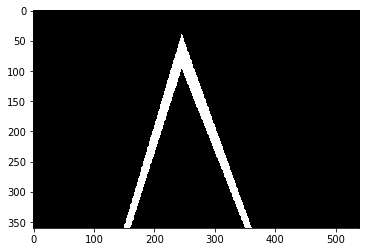

In [9]:
image = mpimg.imread('frames/frame10019.jpg')
imshape = image.shape

gray = grayscale(image)
    
# Define a kernel size and apply Gaussian smoothing
kernel_size = 7
blur_gray = cv2.GaussianBlur(gray,(kernel_size, kernel_size), 0)

# Define our parameters for Canny and apply
low_threshold = 70
high_threshold = 150
edges = cv2.Canny(blur_gray, low_threshold, high_threshold)
mask = np.zeros_like(edges)

ignore_mask_color = 255

vertices = np.array([[(150,imshape[0]), (245, 40), (360, imshape[0]),(350, imshape[0]), 
                      (245, imshape[0]-265), (160,imshape[0])]], dtype=np.int32)
cv2.fillPoly(mask, vertices, ignore_mask_color)
masked_edges = cv2.bitwise_and(edges, mask)
plt.imshow(mask, cmap="gray");

In [10]:
from collections import deque


class CableCarTrack:
    def __init__(self):
        # Was the line found in the previous frame?
        self.found = False
        
        # Remember x and y values of lanes in previous frame
        self.X = None
        self.Y = None
        
        # Store recent x intercepts for averaging across frames
        self.x_int = deque(maxlen=10)
        self.top = deque(maxlen=10)
        
        # Remember previous x intercept to compare against current one
        self.lastx_int = None
        self.last_top = None
        
        # Store recent linear coefficients for averaging across frames
        self.fitm = deque(maxlen=40)
        self.fitb = deque(maxlen=40)
        self.mprev = 0
        self.bprev = 0
        
        # Count the number of frames
        self.count = 0
        
    def avg_track_line(self, detected_track):
        '''
        This function is applied when the tracks have been detected in the previous frame.
        Averages the findings with previous results for smoother transitions. 
        '''
        self.count += 1
        if detected_track != None:
            self.fitm.appendleft(detected_track.slope)
            self.fitb.appendleft(detected_track.b)

            # use m's and b's from fitm and fit b for best fit
            weights = [.025 for i in range(40)]
            weighted_avg_fitm, weighted_avg_fitb = 0, 0
            # if in the first 10 frames, temporarily fill the deque with the average
            if len(self.fitb) < 40:
                m_mean = np.mean(self.fitm)
                b_mean = np.mean(self.fitb)
            temp_fitm = self.fitm.copy()
            temp_fitb = self.fitb.copy()
            for i in range(40-len(self.fitm)):
                temp_fitm.append(m_mean)
                temp_fitb.append(b_mean)
            for i in range(40):
                weighted_avg_fitm += weights[i]* temp_fitm[i]
                weighted_avg_fitb += weights[i]* temp_fitb[i]
            
            self.mprev = weighted_avg_fitm
            self.bprev = weighted_avg_fitb
            
        else:
            # if no track found, use previously found track
            weighted_avg_fitm = self.mprev
            weighted_avg_fitb = self.bprev
        
        
        return weighted_avg_fitm, weighted_avg_fitb
        


### Calculating Distance / Second

[MoviePy] >>>> Building video dist_per_frame_output.mp4
[MoviePy] Writing video dist_per_frame_output.mp4


100%|██████████| 4581/4581 [01:40<00:00, 45.48it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: dist_per_frame_output.mp4 

CPU times: user 1min 20s, sys: 5.71 s, total: 1min 26s
Wall time: 1min 41s


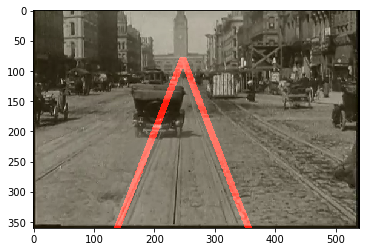

In [12]:
Left = CableCarTrack()
Right = CableCarTrack()

tracks_output = 'dist_per_frame_output.mp4'
clip2  = VideoFileClip('for_measuring_dist.mp4')
fp_clip = clip2.fl_image(process_vid)
%time fp_clip.write_videofile(tracks_output, audio=False)

In [20]:
print("Frames/second:",fp_clip.fps)
print("Duration:", fp_clip.duration)
num_frames = int(fp_clip.fps * fp_clip.duration)
print("Estimated number of frames:", num_frames)
print("Actual number of frames:", Left.count) # frame count tracked in CableCarTrack object

Frames/second: 29.97002997002997
Duration: 152.85
Estimated number of frames: 4580
Actual number of frames: 4582


#### Since we know that the actual distance traveled in this video is 500m:

In [45]:
distance_per_frame = 500/Left.count*3.281
print("Distance per frame (feet):", round(distance_per_frame, 2))

Distance per frame (feet): 0.36


#### How many frames is the full video?

##### Since moviepy doesn't keep track of frame number, below is a simple way to count the number of frames

In [25]:
def fake_process_video(image):
    counter.increment()
    return image

class Count:
    def __init__(self):
        self.count = 0
    
    def increment(self):
        self.count += 1
    
    def get_count(self):
        return self.count

counter = Count()

tracks_output = 'DISCARD.mp4'
clip  = VideoFileClip('MarketStreet1906WithStreetSounds.mp4')
count_frames_clip = clip.fl_image(fake_process_video)
%time count_frames_clip.write_videofile(tracks_output, audio=False)

[MoviePy] >>>> Building video DISCARD.mp4
[MoviePy] Writing video DISCARD.mp4


100%|██████████| 20875/20875 [03:43<00:00, 93.51it/s] 


[MoviePy] Done.
[MoviePy] >>>> Video ready: DISCARD.mp4 

CPU times: user 13.4 s, sys: 9.01 s, total: 22.4 s
Wall time: 3min 43s


#### Number of frames in video

In [43]:
full_vid_frame_count = counter.get_count()
print("Number of frames in video:", full_vid_frame_count)
dist_miles = 1.6
print("Distance traveled (miles):", round(dist_miles, 2))
dist_ft = dist_miles*5280
print("Distance traveled (feet):", round(dist_ft, 2))
dist_per_frame = dist_ft/full_vid_frame_count
print("Distance per frame (feet/frame):", round(dist_per_frame, 2))
print("")
frames_per_sec = count_frames_clip.fps
# convert feet per second to miles per hour
mi_per_hour = dist_per_frame*frames_per_sec/5280*3600
print("Since the video was taken at", round(frames_per_sec, 2) ,"frames/sec, the cable car moves at", round(mi_per_hour, 2), "miles/hour.")

Number of frames in video: 20876
Distance traveled (miles): 1.6
Distance traveled (feet): 8448.0
Distance per frame (feet/frame): 0.4

Since the video was taken at 29.97 frames/sec, the cable car moves at 8.27 miles/hour.


### ISSUE: Should be 9.5 miles/hour. Means video was compiled a bit slow (increasing frames/sec would solve)

In [ ]:
### WRITE THE MATH CALCULATING FOCAL LENGTH
# focal length
f = 1168.5

In [105]:
video = io.open('tracks_focal_pt_test.mp4', 'r+b').read()
encoded = base64.b64encode(video)
HTML(data='''
<video controls>
    <source src="data:video/mp4;base64,{0}" type="video/mp4" />
</video>'''.format(encoded.decode('ascii')))

# Distances using Affine Transformation

TO DO (photogrametry, check out bundle adjustment (like gradient descent)):
    - Calculate focal length (done, thanks Brandon)
    - For each frame:
        - Calculate focal point and the relative location of each item in terms of pixels
        - Calculate A and v for each object detected, need to know how far I went (distance per frame!!!!!!!!!!!!, finds c)
        - find ahat with x and y using object detection
        
        
        
        
NOTE: Google Maps API Key for pulling up map images to draw on
https://console.cloud.google.com/google/maps-apis/api-list?consoleReturnUrl=https:%2F%2Fcloud.google.com%2Fmaps-platform%2Fmaps%2F%3Fapis%3Dmaps%26project%3Daccessibility-deserts-in-sf&consoleUI=CLOUD&project=accessibility-deserts-in-sf
Docs: https://developers.google.com/maps/documentation/maps-static/dev-guide

Not part of MVP: look up sift features for fixed objects (SIFT)

NOTES:

    - Need to keep track of the video skipping ahead. Should be easy to catch because locations will shift dramatically
    - 